In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import sklearn
import shap
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.neural_network import MLPRegressor
pd.set_option('display.max_columns', None) 
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
import scipy.stats as st
import pickle

In [2]:
listings_raw = pd.read_csv('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/data/raw/listings2.csv')
display(listings_raw.head())

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,39971294,https://www.airbnb.com/rooms/39971294,20220613034419,2022-06-13,Cozy flat with chimney,NaN,NaN,https://a0.muscache.com/pictures/a10c1d51-2954...,21565256,https://www.airbnb.com/users/show/21565256,Tanja,2014-09-20,"Berlin, Berlin, Germany",Hey there! I´m a Bavarian girl living in the b...,NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/33341...,https://a0.muscache.com/im/pictures/user/33341...,NaN,1.0,1.0,"['email', 'phone', 'work_email']",t,t,NaN,nördliche Luisenstadt,Friedrichshain-Kreuzberg,52.501680,13.415730,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,1,1125,1,1,1125,1125,1.0,1125.0,NaN,t,0,0,0,0,2022-06-13,2,0,0,2019-11-16,2019-12-02,5.00,5.00,5.00,5.00,5.00,5.00,5.00,NaN,f,1,1,0,0,0.06
1,11934470,https://www.airbnb.com/rooms/11934470,20220613034419,2022-06-13,Bright Studio Apartment / 4th fl/ long term,Just renovedt Studio apartment a few steps fro...,NaN,https://a0.muscache.com/pictures/56a1ce3f-e2c6...,62819516,https://www.airbnb.com/users/show/62819516,Carla & Daniel,2016-03-13,"Berlin, Berlin, Germany",NaN,within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/7db64...,https://a0.muscache.com/im/pictures/user/7db64...,Neukölln,2.0,2.0,"['email', 'phone']",t,t,NaN,Reuterstraße,Neukölln,52.492260,13.429370,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,30,730,5,60,7,1125,38.4,823.8,NaN,t,0,7,8,271,2022-06-13,5,3,0,2016-04-27,2022-03-29,4.60,5.00,4.80,4.40,4.80,4.60,4.20,NaN,t,2,2,0,0,0.07
2,17580693,https://www.airbnb.com/rooms/17580693,20220613034419,2022-06-13,"Gemütliches, Zentrales Zimmer mit Blick ins Grüne","Meine Unterkunft ist gut für paare, alleinreis...",NaN,https://a0.muscache.com/pictures/91db5cb4-ab79...,119416956,https://www.airbnb.com/users/show/119416956,Sven,2017-03-06,"Berlin, Berlin, Germany",NaN,within a few hours,100%,62%,f,https://a0.muscache.com/im/pictures/user/6372a...,https://a0.muscache.com/im/pictures/user/6372a...,Wedding,1.0,1.0,"['email', 'phone']",t,t,NaN,Parkviertel,Mitte,52.561510,13.355150,Private room in condo,Private room,1,NaN,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,2,10,2,2,10,10,2.0,10.0,NaN,t,0,0,10,10,2022-06-13,31,4,0,2017-05-28,2022-03-07,4.65,4.77,4.58,4.81,4.84,4.71,4.68,NaN,f,1,0,1,0,0.50
3,579471587567149993,https://www.airbnb.com/rooms/579471587567149993,20220613034419,2022-06-13,Süßes Altbau-Apartment in Schöneberg,"Praktikum, berufliches Projekt oder Besuch bei...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,9916942,https://www.airbnb.com/u

In [3]:
listings_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16416 entries, 0 to 16415
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            16416 non-null  int64  
 1   listing_url                                   16416 non-null  object 
 2   scrape_id                                     16416 non-null  int64  
 3   last_scraped                                  16416 non-null  object 
 4   name                                          16392 non-null  object 
 5   description                                   16067 non-null  object 
 6   neighborhood_overview                         8706 non-null   object 
 7   picture_url                                   16416 non-null  object 
 8   host_id                                       16416 non-null  int64  
 9   host_url                                      16416 non-null 

In [4]:
### I will remove the columns that I think wont be relevant for the model

listings = listings_raw.drop(["listing_url", "scrape_id", "host_url", "host_location",
                         "host_thumbnail_url", "host_neighbourhood", "host_listings_count",
                         "neighborhood_overview", "minimum_minimum_nights",
                         "maximum_minimum_nights", "minimum_maximum_nights", "maximum_maximum_nights",
                         "minimum_nights_avg_ntm", "maximum_nights_avg_ntm", 
                         "description", "host_about", "has_availability", "availability_30", 
                         "availability_60", "availability_90", "availability_365",
                         "picture_url", "host_picture_url", "last_scraped",
                         "name", "host_id", "host_name", "host_since",
                         "host_has_profile_pic", "calendar_last_scraped",
                         "number_of_reviews_ltm", "number_of_reviews_l30d",
                         "first_review", "last_review", "calculated_host_listings_count_entire_homes",
                         "calculated_host_listings_count_private_rooms", "calculated_host_listings_count_shared_rooms",
                         "host_total_listings_count", "host_identity_verified", "latitude",
                         "longitude", "maximum_nights", "minimum_nights",
                         "calculated_host_listings_count", "number_of_reviews"], axis = 1)
listings.head()

,id,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_verifications,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,calendar_updated,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,reviews_per_month
0,39971294,NaN,NaN,NaN,f,"['email', 'phone', 'work_email']",NaN,nördliche Luisenstadt,Friedrichshain-Kreuzberg,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,NaN,5.00,5.00,5.00,5.00,5.00,5.00,5.00,NaN,f,0.06
1,11934470,within an hour,100%,100%,t,"['email', 'phone']",NaN,Reuterstraße,Neukölln,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,NaN,4.60,5.00,4.80,4.40,4.80,4.60,4.20,NaN,t,0.07
2,17580693,within a few hours,100%,62%,f,"['email', 'phone']",NaN,Parkviertel,Mitte,Private room in condo,Private room,1,NaN,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,NaN,4.65,4.77,4.58,4.81,4.84,4.71,4.68,NaN,f,0.50
3,579471587567149993,NaN,NaN,NaN,f,"['email', 'phone']",NaN,Friedenau,Tempelhof - Schöneberg,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,2.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$52.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,NaN
4,17497917,within a few hours,100%,92%,t,"['email', 'phone', 'work_email']","Berlin, Germany",Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Essentials"", ""Long term stays allowed"", ""Pai...",$106.00,NaN,4.90,4.94,4.95,4.84,4.87,4.96,4.70,NaN,f,1.84


In [5]:
### Now I will check for missing values 

listings.isna().sum()

id                                  0
host_response_time               8393
host_response_rate               8393
host_acceptance_rate             7405
host_is_superhost                  10
host_verifications                  0
neighbourhood                    7709
neighbourhood_cleansed              0
neighbourhood_group_cleansed        0
property_type                       0
room_type                           0
accommodates                        0
bathrooms                       16416
bathrooms_text                     18
bedrooms                         1370
beds                              339
amenities                           0
price                               0
calendar_updated                16416
review_scores_rating             2883
review_scores_accuracy           3150
review_scores_cleanliness        3148
review_scores_checkin            3162
review_scores_communication      3151
review_scores_location           3161
review_scores_value              3163
license     

In [6]:
### I will remove the following columns since they contain too many missing values
### and will also probably wont be too relevant for the model

listings = listings.drop(["host_response_time", "host_response_rate", "neighbourhood",
                         "bathrooms", "calendar_updated", "license", "host_acceptance_rate",
                         "review_scores_rating", "review_scores_accuracy", "review_scores_cleanliness", "review_scores_checkin", "review_scores_communication", 
                          "review_scores_location", "review_scores_value", "reviews_per_month"], axis = 1)
listings.head()

,id,host_is_superhost,host_verifications,neighbourhood_cleansed,neighbourhood_group_cleansed,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,instant_bookable
0,39971294,f,"['email', 'phone', 'work_email']",nördliche Luisenstadt,Friedrichshain-Kreuzberg,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,f
1,11934470,t,"['email', 'phone']",Reuterstraße,Neukölln,Entire rental unit,Entire home/apt,1,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,t
2,17580693,f,"['email', 'phone']",Parkviertel,Mitte,Private room in condo,Private room,1,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,f
3,579471587567149993,f,"['email', 'phone']",Friedenau,Tempelhof - Schöneberg,Entire rental unit,Entire home/apt,2,1 bath,1.0,2.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$52.00,t
4,17497917,t,"['email', 'phone', 'work_email']",Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Essentials"", ""Long term stays allowed"", ""Pai...",$106.00,f


In [7]:
listings.isna().sum()

id                                 0
host_is_superhost                 10
host_verifications                 0
neighbourhood_cleansed             0
neighbourhood_group_cleansed       0
property_type                      0
room_type                          0
accommodates                       0
bathrooms_text                    18
bedrooms                        1370
beds                             339
amenities                          0
price                              0
instant_bookable                   0
dtype: int64

In [8]:
### I will drop the Nas of these columns, since the number is not so big

listings = listings.dropna(subset=["host_is_superhost", "bathrooms_text", "bedrooms", "beds"])
print(listings.isna().sum())
print(listings.shape)

id                              0
host_is_superhost               0
host_verifications              0
neighbourhood_cleansed          0
neighbourhood_group_cleansed    0
property_type                   0
room_type                       0
accommodates                    0
bathrooms_text                  0
bedrooms                        0
beds                            0
amenities                       0
price                           0
instant_bookable                0
dtype: int64
(14731, 14)


In [9]:
### Now I will take a look a the column types

listings.info()

### Clearly, it seems "price" needs to be cleaned, also, the number of bathrooms should be an interger

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14731 entries, 0 to 16413
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            14731 non-null  int64  
 1   host_is_superhost             14731 non-null  object 
 2   host_verifications            14731 non-null  object 
 3   neighbourhood_cleansed        14731 non-null  object 
 4   neighbourhood_group_cleansed  14731 non-null  object 
 5   property_type                 14731 non-null  object 
 6   room_type                     14731 non-null  object 
 7   accommodates                  14731 non-null  int64  
 8   bathrooms_text                14731 non-null  object 
 9   bedrooms                      14731 non-null  float64
 10  beds                          14731 non-null  float64
 11  amenities                     14731 non-null  object 
 12  price                         14731 non-null  object 
 13  i

In [10]:
### Now I will take a closer look at the columns to clean them 
### I will first clean the column "bathrooms_text"

listings["bathrooms_text"].value_counts(dropna = False)

1 bath               8264
1 shared bath        3377
1 private bath        843
2 baths               748
1.5 baths             714
1.5 shared baths      334
2 shared baths        186
2.5 baths             109
3 baths                30
Half-bath              27
0 shared baths         25
2.5 shared baths       16
Shared half-bath       12
4 baths                10
0 baths                 9
3.5 baths               8
Private half-bath       5
4.5 shared baths        3
4.5 baths               3
7 baths                 2
4 shared baths          2
6 baths                 1
8 baths                 1
3 shared baths          1
5 baths                 1
Name: bathrooms_text, dtype: int64

In [11]:
def clean_bath(x):
    if "shared" in x:
        return 0
    if re.match('\d{1}.\d{1}', x):
        y = re.findall('\d{1}.\d{1}', x)
        return y[0]
    if re.match('\d{1}', x):
        y = re.findall('\d{1}', x)
        return y[0]
    else:
        return "0.5"

In [12]:
listings["bathrooms_text"] = list(map(clean_bath, listings["bathrooms_text"]))
listings["bathrooms_text"] = pd.to_numeric(listings["bathrooms_text"])
listings["bathrooms_text"].value_counts()

1.0    9107
0.0    3953
2.0     748
1.5     714
2.5     109
0.5      44
3.0      30
4.0      10
3.5       8
4.5       3
7.0       2
6.0       1
8.0       1
5.0       1
Name: bathrooms_text, dtype: int64

In [13]:
listings = listings.rename(columns={'bathrooms_text': 'n_bathrooms'})
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14731 entries, 0 to 16413
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            14731 non-null  int64  
 1   host_is_superhost             14731 non-null  object 
 2   host_verifications            14731 non-null  object 
 3   neighbourhood_cleansed        14731 non-null  object 
 4   neighbourhood_group_cleansed  14731 non-null  object 
 5   property_type                 14731 non-null  object 
 6   room_type                     14731 non-null  object 
 7   accommodates                  14731 non-null  int64  
 8   n_bathrooms                   14731 non-null  float64
 9   bedrooms                      14731 non-null  float64
 10  beds                          14731 non-null  float64
 11  amenities                     14731 non-null  object 
 12  price                         14731 non-null  object 
 13  i

In [14]:
### Now I will clean the column "price"

listings["price"].value_counts()

$50.00       611
$30.00       553
$40.00       543
$35.00       500
$60.00       474
            ... 
$431.00        1
$555.00        1
$4,000.00      1
$302.00        1
$520.00        1
Name: price, Length: 458, dtype: int64

In [15]:
def clean_price(x):
    y = ""
    for char in x:
        if char == "$":
            pass
        elif char == ",":
            pass
        else:
            y = y + char
    return y

In [16]:
listings["price"] = list(map(clean_price, listings["price"]))
listings["price"] = pd.to_numeric(listings["price"])
listings["price"].value_counts()

50.0      611
30.0      553
40.0      543
35.0      500
60.0      474
         ... 
431.0       1
555.0       1
4000.0      1
302.0       1
520.0       1
Name: price, Length: 458, dtype: int64

In [17]:
### Now I want to extract some features from the column "ammenities" to see whether 
### they would add an extra value to the property

pd.set_option('max_colwidth', None)
pd.set_option('display.max_rows', None)
listings[["amenities"]]

,amenities
0,"[""Indoor fireplace"", ""Essentials"", ""Hot water"", ""Free parking on premises"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Wifi"", ""Smoke alarm""]"
2,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating"", ""TV"", ""Wifi"", ""Hangers""]"
3,"[""Long term stays allowed"", ""Washer"", ""Kitchen"", ""Dedicated workspace"", ""Wifi"", ""Smoke alarm""]"
4,"[""Essentials"", ""Long term stays allowed"", ""Paid parking on premises"", ""Hair dryer"", ""Coffee maker"", ""Refrigerator"", ""Stove"", ""Private patio or balcony"", ""Cooking basics"", ""Wifi"", ""Bed linens"", ""Hot water kettle"", ""Dishes and silverware"", ""65\"" HDTV with Roku, Apple TV, Amazon Prime Video, Netflix"", ""Bose Bluetooth sound system"", ""Kitchen"", ""Iron"", ""Toaster"", ""Heating"", ""Dishwasher"", ""Hangers"", ""Oven"", ""Hot water"", ""Rice maker"", ""Washer"", ""Microwave"", ""Freezer""]"
5,"[""Essentials"", ""Hot water"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Heating"", ""Wifi"", ""Bed linens"", ""Hangers""]"
6,"[""Essentials"", ""Hot water"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Heating"", ""Wifi"", ""Smoke alarm"", ""Hangers""]"
7,"[""Long term stays allowed"", ""Washer"", ""Kitchen"", ""Elevator"", ""Wifi""]"
8,"[""Dishes and silverware"", ""Shampoo"", ""Essentials"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Microwave"", ""Refrigerator"", ""Toaster"", ""Heating"", ""Cooking basics"", ""TV"", ""Wifi"", ""Bed linens"", ""Hot water kettle"", ""Hangers""]"
9,"[""Essentials"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Heating"", ""TV"", ""Wifi"", ""Hangers""]"
10,"[""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Heating"", ""Wifi"", ""Smoke alarm""]"


In [18]:
pd.reset_option('max_colwidth', 10)
pd.reset_option('display.max_rows', 10)

In [19]:
def clean_ammenities_wifi(row):
    if "Wifi" in row["amenities"]:
        return 1
    else:
        return 0

In [20]:
def clean_ammenities_kitchen(row):
    if "Kitchen" in row["amenities"]:
        return 1
    else:
        return 0

In [21]:
def clean_ammenities_parking(row):
    if "parking" in row["amenities"]:
        return 1
    else:
        return 0

In [22]:
def clean_ammenities_balcony(row):
    if "balcony" in row["amenities"]:
        return 1
    else:
        return 0

In [23]:
def clean_ammenities_bbq(row):
    if "BBQ grill" in row["amenities"]:
        return 1
    else:
        return 0

In [24]:
def clean_ammenities_washer(row):
    if "Washer" in row["amenities"]:
        return 1
    else:
        return 0

In [25]:
function = {"wifi":clean_ammenities_wifi, "kitchen":clean_ammenities_kitchen, 
            "parking":clean_ammenities_parking, "balcony":clean_ammenities_balcony,
            "bbq":clean_ammenities_bbq, "washer":clean_ammenities_washer}

for key,value in function.items():
    listings[key] = listings.apply(value, axis = 1)
    
listings = listings.drop(["amenities"], axis = 1)

In [26]:
listings.head()

,id,host_is_superhost,host_verifications,neighbourhood_cleansed,neighbourhood_group_cleansed,property_type,room_type,accommodates,n_bathrooms,bedrooms,beds,price,instant_bookable,wifi,kitchen,parking,balcony,bbq,washer
0,39971294,f,"['email', 'phone', 'work_email']",nördliche Luisenstadt,Friedrichshain-Kreuzberg,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,50.0,f,1,1,1,0,0,1
2,17580693,f,"['email', 'phone']",Parkviertel,Mitte,Private room in condo,Private room,1,0.0,1.0,1.0,42.0,f,1,0,0,0,0,0
3,579471587567149993,f,"['email', 'phone']",Friedenau,Tempelhof - Schöneberg,Entire rental unit,Entire home/apt,2,1.0,1.0,2.0,52.0,t,1,1,0,0,0,1
4,17497917,t,"['email', 'phone', 'work_email']",Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,106.0,f,1,1,1,1,0,1
5,9924899,f,"['email', 'phone']",Tempelhofer Vorstadt,Friedrichshain-Kreuzberg,Private room in rental unit,Private room,1,0.0,1.0,1.0,39.0,f,1,1,0,0,0,0


In [27]:
### Now I want to extract features from the column host_verifications

listings["host_verifications"].value_counts()

['email', 'phone']                                  12146
['email', 'phone', 'work_email']                     1646
['phone']                                             859
['phone', 'work_email']                                46
['email']                                              28
[]                                                      3
['email', 'work_email']                                 1
['email', 'phone', 'photographer']                      1
['email', 'phone', 'photographer', 'work_email']        1
Name: host_verifications, dtype: int64

In [28]:
def clean_hostverification_email(row):
    if "email" in row["host_verifications"]:
        return 1
    else:
        return 0

In [29]:
def clean_hostverification_phone(row):
    if "phone" in row["host_verifications"]:
        return 1
    else:
        return 0

In [30]:
def clean_hostverification_work_email(row):
    if "work_email" in row["host_verifications"]:
        return 1
    else:
        return 0

In [31]:
function = {"host_email":clean_hostverification_email, "host_phone":clean_hostverification_phone, 
            "host_work_email":clean_hostverification_work_email}

for key,value in function.items():
    listings[key] = listings.apply(value, axis = 1)
    
listings = listings.drop(["host_verifications"], axis = 1)
listings.head()

,id,host_is_superhost,neighbourhood_cleansed,neighbourhood_group_cleansed,property_type,room_type,accommodates,n_bathrooms,bedrooms,beds,price,instant_bookable,wifi,kitchen,parking,balcony,bbq,washer,host_email,host_phone,host_work_email
0,39971294,f,nördliche Luisenstadt,Friedrichshain-Kreuzberg,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,50.0,f,1,1,1,0,0,1,1,1,1
2,17580693,f,Parkviertel,Mitte,Private room in condo,Private room,1,0.0,1.0,1.0,42.0,f,1,0,0,0,0,0,1,1,0
3,579471587567149993,f,Friedenau,Tempelhof - Schöneberg,Entire rental unit,Entire home/apt,2,1.0,1.0,2.0,52.0,t,1,1,0,0,0,1,1,1,0
4,17497917,t,Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,106.0,f,1,1,1,1,0,1,1,1,1
5,9924899,f,Tempelhofer Vorstadt,Friedrichshain-Kreuzberg,Private room in rental unit,Private room,1,0.0,1.0,1.0,39.0,f,1,1,0,0,0,0,1,1,0


In [32]:
### I want to filter out the rows of neighbourhood_cleansed column that have less that 30
### values 

listings["neighbourhood_cleansed"].value_counts()

Frankfurter Allee Süd FK     799
Alexanderplatz               798
Tempelhofer Vorstadt         744
Reuterstraße                 591
Brunnenstr. Süd              545
                            ... 
Allende-Viertel                3
Neu-Hohenschönhausen Nord      2
Hellersdorf-Ost                1
Forst Grunewald                1
Hellersdorf-Süd                1
Name: neighbourhood_cleansed, Length: 137, dtype: int64

In [33]:
def clean_nc(row):
    lst = list(listings["neighbourhood_cleansed"].value_counts().loc[lambda x : x>30].to_frame().reset_index()["index"])
    if row["neighbourhood_cleansed"] in lst:
        return row["neighbourhood_cleansed"]
    else:
        return "Other"

In [34]:
listings["neighbourhood_cleansed"] = listings.apply(clean_nc, axis = 1)
listings["neighbourhood_cleansed"].value_counts()

Other                       908
Frankfurter Allee Süd FK    799
Alexanderplatz              798
Tempelhofer Vorstadt        744
Reuterstraße                591
                           ... 
Wiesbadener Straße           34
Ost 1                        33
Schloßstr.                   32
Rummelsburger Bucht          31
Heerstrasse                  31
Name: neighbourhood_cleansed, Length: 75, dtype: int64

In [35]:
### I also want to filter out the rows of property_type column that have less that 30
### values 

listings["property_type"].value_counts()

Entire rental unit             6866
Private room in rental unit    5075
Entire condo                    565
Entire serviced apartment       300
Entire loft                     268
                               ... 
Shared room in boat               1
Private room in tent              1
Bus                               1
Private room in cave              1
Shared room in home               1
Name: property_type, Length: 65, dtype: int64

In [36]:
def clean_pt(row):
    lst = list(listings["property_type"].value_counts().loc[lambda x : x>30].to_frame().reset_index()["index"])
    if row["property_type"] in lst:
        return row["property_type"]
    else:
        return "Other"

In [37]:
listings["property_type"] = listings.apply(clean_pt, axis = 1)
listings["property_type"].value_counts()

Entire rental unit                   6866
Private room in rental unit          5075
Entire condo                          565
Other                                 346
Entire serviced apartment             300
Entire loft                           268
Private room in condo                 211
Private room in home                  195
Entire home                           180
Room in hotel                         173
Shared room in rental unit             88
Room in boutique hotel                 77
Shared room in hostel                  68
Private room in loft                   61
Private room in bed and breakfast      50
Entire guesthouse                      49
Private room in hostel                 46
Private room in townhouse              43
Room in aparthotel                     39
Room in serviced apartment             31
Name: property_type, dtype: int64

In [38]:
### Now I want to see whether there is any relaitionship between the categorical columns 
### "neighbourhood_cleansed" and "property_type" have too many values and will generate NAs, so
### I will not do the test with them 

cols1 = ["neighbourhood_group_cleansed"]
cols2 = ["room_type", 
       "instant_bookable", "host_is_superhost"]
for col1 in cols1:
    for col2 in cols2:
        x1 = listings.groupby([col1, col2]).agg({col2:"count"})
        x1.columns = ["Count"]
        x1 = x1.reset_index()
        x1 = x1.pivot(index=col1,columns=col2).reset_index()
        display(x1)
        x1 = x1.iloc[:,1:]
        print("Chi2 test for", col1, "vs", col2, "is:", st.chi2_contingency(x1))


neighbourhood_group_cleansed           Count             \
room_type                              Entire home/apt Hotel room   
0                 Charlottenburg-Wilm.           626.0       24.0   
1             Friedrichshain-Kreuzberg          1771.0        9.0   
2                          Lichtenberg           243.0        2.0   
3                Marzahn - Hellersdorf            74.0        1.0   
4                                Mitte          1898.0       35.0   
5                             Neukölln           982.0        NaN   
6                               Pankow          1544.0       22.0   
7                        Reinickendorf           113.0        NaN   
8                              Spandau           105.0        8.0   
9                Steglitz - Zehlendorf           253.0        NaN   
10              Tempelhof - Schöneberg           514.0       23.0   
11                  Treptow - Köpenick           327.0        NaN   

                                    
room_type Private room Shared room  
0                450.0        13.0  
1               1456.0        51.0  
2                194.0         8.0  
3                 46.0         NaN  
4               1144.0        61.0  
5               1028.0        11.0  
6                790.0        15.0  
7                 98.0         4.0  
8                 35.0         NaN  
9                147.0         1.0  
10               410.0         8.0  
11               183.0         4.0

Chi2 test for neighbourhood_group_cleansed vs room_type is: (nan, nan, 33, array([[nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan],
       [nan, nan, nan, nan]]))


neighbourhood_group_cleansed Count      
instant_bookable                                  f     t
0                        Charlottenburg-Wilm.   678   435
1                    Friedrichshain-Kreuzberg  2303   984
2                                 Lichtenberg   310   137
3                       Marzahn - Hellersdorf    67    54
4                                       Mitte  2018  1120
5                                    Neukölln  1489   532
6                                      Pankow  1655   716
7                               Reinickendorf   135    80
8                                     Spandau    92    56
9                       Steglitz - Zehlendorf   259   142
10                     Tempelhof - Schöneberg   611   344
11                         Treptow - Köpenick   333   181

Chi2 test for neighbourhood_group_cleansed vs instant_bookable is: (108.92326657252009, 3.0051638452643555e-18, 11, array([[ 751.77177381,  361.22822619],
       [2220.19211187, 1066.80788813],
       [ 301.92451293,  145.07548707],
       [  81.72900686,   39.27099314],
       [2119.55060756, 1018.44939244],
       [1365.0770484 ,  655.9229516 ],
       [1601.48326658,  769.51673342],
       [ 145.2209626 ,   69.7790374 ],
       [  99.96605797,   48.03394203],
       [ 270.8539814 ,  130.1460186 ],
       [ 645.05125246,  309.94874754],
       [ 347.17941755,  166.82058245]]))


neighbourhood_group_cleansed Count     
host_is_superhost                                  f    t
0                         Charlottenburg-Wilm.   951  162
1                     Friedrichshain-Kreuzberg  2961  326
2                                  Lichtenberg   403   44
3                        Marzahn - Hellersdorf    88   33
4                                        Mitte  2706  432
5                                     Neukölln  1895  126
6                                       Pankow  2083  288
7                                Reinickendorf   178   37
8                                      Spandau   123   25
9                        Steglitz - Zehlendorf   312   89
10                      Tempelhof - Schöneberg   842  113
11                          Treptow - Köpenick   422   92

Chi2 test for neighbourhood_group_cleansed vs host_is_superhost is: (187.3844088878976, 3.054484676815015e-34, 11, array([[ 979.49439957,  133.50560043],
       [2892.72065712,  394.27934288],
       [ 393.3818478 ,   53.6181522 ],
       [ 106.48591406,   14.51408594],
       [2761.59337452,  376.40662548],
       [1778.57877944,  242.42122056],
       [2086.59588623,  284.40411377],
       [ 189.21050845,   25.78949155],
       [ 130.24723372,   17.75276628],
       [ 352.89959948,   48.10040052],
       [ 840.44667708,  114.55332292],
       [ 452.34512253,   61.65487747]]))


In [39]:
cols1 = ["room_type"]
cols2 = ["neighbourhood_group_cleansed", 
       "instant_bookable", "host_is_superhost"]
for col1 in cols1:
    for col2 in cols2:
        x1 = listings.groupby([col1, col2]).agg({col2:"count"})
        x1.columns = ["Count"]
        x1 = x1.reset_index()
        x1 = x1.pivot(index=col1,columns=col2).reset_index()
        display(x1)
        x1 = x1.iloc[:,1:]
        print("Chi2 test for", col1, "vs", col2, "is:", st.chi2_contingency(x1))

room_type                Count  \
neighbourhood_group_cleansed                  Charlottenburg-Wilm.   
0                             Entire home/apt                626.0   
1                                  Hotel room                 24.0   
2                                Private room                450.0   
3                                 Shared room                 13.0   

                                                                   \
neighbourhood_group_cleansed Friedrichshain-Kreuzberg Lichtenberg   
0                                              1771.0       243.0   
1                                                 9.0         2.0   
2                                              1456.0       194.0   
3                                                51.0         8.0   

                                                                             \
neighbourhood_group_cleansed Marzahn - Hellersdorf   Mitte Neukölln  Pankow   
0                                             74.0  1898.0    982.0  1544.0   
1                                              1.0    35.0      NaN    22.0   
2                                             46.0  1144.0   1028.0   790.0   
3                                              NaN    61.0     11.0    15.0   

                                                                          \
neighbourhood_group_cleansed Reinickendorf Spandau Steglitz - Zehlendorf   
0                                    113.0   105.0                 253.0   
1                                      NaN     8.0                   NaN   
2                                     98.0    35.0                 147.0   
3                                      4.0     NaN                   1.0   

                                                                        
neighbourhood_group_cleansed Tempelhof - Schöneberg Treptow - Köpenick  
0                                             514.0              327.0  
1                                              23.0                NaN  
2                                             410.0              183.0  
3                                               8.0                4.0

Chi2 test for room_type vs neighbourhood_group_cleansed is: (nan, nan, 33, array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]]))


room_type Count      
instant_bookable                      f     t
0                 Entire home/apt  5786  2664
1                      Hotel room     5   119
2                    Private room  4059  1922
3                     Shared room   100    76

Chi2 test for room_type vs instant_bookable is: (241.01332637564735, 5.746092382459786e-52, 3, array([[5707.52155319, 2742.47844681],
       [  83.75534587,   40.24465413],
       [4039.84454552, 1941.15545448],
       [ 118.87855543,   57.12144457]]))


room_type Count      
host_is_superhost                      f     t
0                  Entire home/apt  7230  1220
1                       Hotel room   111    13
2                     Private room  5451   530
3                      Shared room   172     4

Chi2 test for room_type vs host_is_superhost is: (119.43197051714179, 1.0227493427206018e-25, 3, array([[7436.41300658, 1013.58699342],
       [ 109.12606069,   14.87393931],
       [5263.57233046,  717.42766954],
       [ 154.88860227,   21.11139773]]))


In [40]:
cols1 = ["instant_bookable"]
cols2 = ["neighbourhood_group_cleansed", "room_type",
       "host_is_superhost"]
for col1 in cols1:
    for col2 in cols2:
        x1 = listings.groupby([col1, col2]).agg({col2:"count"})
        x1.columns = ["Count"]
        x1 = x1.reset_index()
        x1 = x1.pivot(index=col1,columns=col2).reset_index()
        display(x1)
        x1 = x1.iloc[:,1:]
        print("Chi2 test for", col1, "vs", col2, "is:", st.chi2_contingency(x1))

instant_bookable                Count  \
neighbourhood_group_cleansed                  Charlottenburg-Wilm.   
0                                           f                  678   
1                                           t                  435   

                                                                   \
neighbourhood_group_cleansed Friedrichshain-Kreuzberg Lichtenberg   
0                                                2303         310   
1                                                 984         137   

                                                                          \
neighbourhood_group_cleansed Marzahn - Hellersdorf Mitte Neukölln Pankow   
0                                               67  2018     1489   1655   
1                                               54  1120      532    716   

                                                                          \
neighbourhood_group_cleansed Reinickendorf Spandau Steglitz - Zehlendorf   
0                                      135      92                   259   
1                                       80      56                   142   

                                                                        
neighbourhood_group_cleansed Tempelhof - Schöneberg Treptow - Köpenick  
0                                               611                333  
1                                               344                181

Chi2 test for instant_bookable vs neighbourhood_group_cleansed is: (108.92326657252009, 3.0051638452643555e-18, 11, array([[ 751.77177381, 2220.19211187,  301.92451293,   81.72900686,
        2119.55060756, 1365.0770484 , 1601.48326658,  145.2209626 ,
          99.96605797,  270.8539814 ,  645.05125246,  347.17941755],
       [ 361.22822619, 1066.80788813,  145.07548707,   39.27099314,
        1018.44939244,  655.9229516 ,  769.51673342,   69.7790374 ,
          48.03394203,  130.1460186 ,  309.94874754,  166.82058245]]))


instant_bookable           Count                                    
room_type                  Entire home/apt Hotel room Private room Shared room
0                        f            5786          5         4059         100
1                        t            2664        119         1922          76

Chi2 test for instant_bookable vs room_type is: (241.01332637564738, 5.7460923824597034e-52, 3, array([[5707.52155319,   83.75534587, 4039.84454552,  118.87855543],
       [2742.47844681,   40.24465413, 1941.15545448,   57.12144457]]))


instant_bookable Count      
host_is_superhost                      f     t
0                                f  8875  1075
1                                t  4089   692

Chi2 test for instant_bookable vs host_is_superhost is: (40.85488462753159, 1.639629227095727e-10, 1, array([[8756.48632136, 1193.51367864],
       [4207.51367864,  573.48632136]]))


In [41]:
cols1 = ["host_is_superhost"]
cols2 = ["neighbourhood_group_cleansed", "room_type",
       "instant_bookable"]
for col1 in cols1:
    for col2 in cols2:
        x1 = listings.groupby([col1, col2]).agg({col2:"count"})
        x1.columns = ["Count"]
        x1 = x1.reset_index()
        x1 = x1.pivot(index=col1,columns=col2).reset_index()
        display(x1)
        x1 = x1.iloc[:,1:]
        print("Chi2 test for", col1, "vs", col2, "is:", st.chi2_contingency(x1))

host_is_superhost                Count  \
neighbourhood_group_cleansed                   Charlottenburg-Wilm.   
0                                            f                  951   
1                                            t                  162   

                                                                   \
neighbourhood_group_cleansed Friedrichshain-Kreuzberg Lichtenberg   
0                                                2961         403   
1                                                 326          44   

                                                                          \
neighbourhood_group_cleansed Marzahn - Hellersdorf Mitte Neukölln Pankow   
0                                               88  2706     1895   2083   
1                                               33   432      126    288   

                                                                          \
neighbourhood_group_cleansed Reinickendorf Spandau Steglitz - Zehlendorf   
0                                      178     123                   312   
1                                       37      25                    89   

                                                                        
neighbourhood_group_cleansed Tempelhof - Schöneberg Treptow - Köpenick  
0                                               842                422  
1                                               113                 92

Chi2 test for host_is_superhost vs neighbourhood_group_cleansed is: (187.38440888789762, 3.0544846768149717e-34, 11, array([[ 979.49439957, 2892.72065712,  393.3818478 ,  106.48591406,
        2761.59337452, 1778.57877944, 2086.59588623,  189.21050845,
         130.24723372,  352.89959948,  840.44667708,  452.34512253],
       [ 133.50560043,  394.27934288,   53.6181522 ,   14.51408594,
         376.40662548,  242.42122056,  284.40411377,   25.78949155,
          17.75276628,   48.10040052,  114.55332292,   61.65487747]]))


host_is_superhost           Count                          \
room_type                   Entire home/apt Hotel room Private room   
0                         f            7230        111         5451   
1                         t            1220         13          530   

                       
room_type Shared room  
0                 172  
1                   4

Chi2 test for host_is_superhost vs room_type is: (119.43197051714179, 1.0227493427206018e-25, 3, array([[7436.41300658,  109.12606069, 5263.57233046,  154.88860227],
       [1013.58699342,   14.87393931,  717.42766954,   21.11139773]]))


host_is_superhost Count      
instant_bookable                       f     t
0                                f  8875  4089
1                                t  1075   692

Chi2 test for host_is_superhost vs instant_bookable is: (40.85488462753159, 1.639629227095727e-10, 1, array([[8756.48632136, 4207.51367864],
       [1193.51367864,  573.48632136]]))


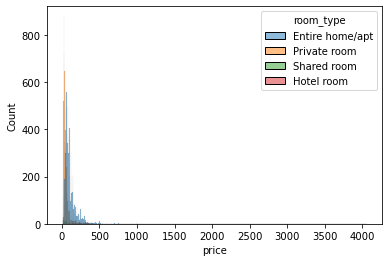

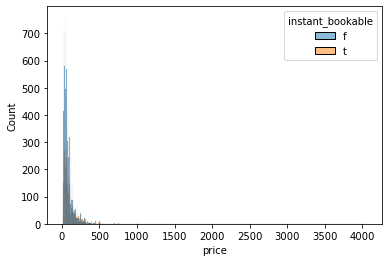

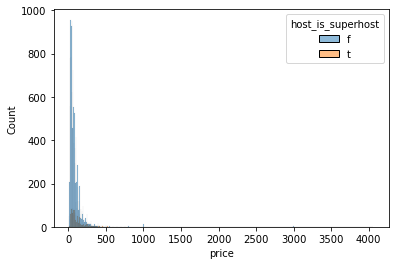

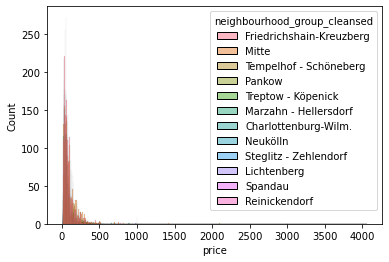

In [42]:
### It seems that column neighbourhood_group_cleansed is dependent on cols instant_bookable and host_is_superhost
### Room_type is dependent on instant_bookable and host_is_superhost
### I will look at the distribution of price in these categories and eliminate the cols where
### I dont see much change

cols = ["room_type", "instant_bookable", "host_is_superhost", "neighbourhood_group_cleansed"]
for col in cols:
    sns.histplot(x= "price", data = listings, hue =col)
    plt.show()

In [43]:
### I will then eliminate instant_bookable and host_is_superhost 

listings = listings.drop(["instant_bookable", "host_is_superhost"], axis = 1)
listings

,id,neighbourhood_cleansed,neighbourhood_group_cleansed,property_type,room_type,accommodates,n_bathrooms,bedrooms,beds,price,wifi,kitchen,parking,balcony,bbq,washer,host_email,host_phone,host_work_email
0,39971294,nördliche Luisenstadt,Friedrichshain-Kreuzberg,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,50.0,1,1,1,0,0,1,1,1,1
2,17580693,Parkviertel,Mitte,Private room in condo,Private room,1,0.0,1.0,1.0,42.0,1,0,0,0,0,0,1,1,0
3,579471587567149993,Friedenau,Tempelhof - Schöneberg,Entire rental unit,Entire home/apt,2,1.0,1.0,2.0,52.0,1,1,0,0,0,1,1,1,0
4,17497917,Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,106.0,1,1,1,1,0,1,1,1,1
5,9924899,Tempelhofer Vorstadt,Friedrichshain-Kreuzberg,Private room in rental unit,Private room,1,0.0,1.0,1.0,39.0,1,1,0,0,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16409,52281412,Other,Marzahn - Hellersdorf,Private room in rental unit,Private room,1,2.0,1.0,1.0,20.0,1,1,0,0,0,1,1,1,0
16410,2648992,Other,Lichtenberg,Other,Private room,2,0.0,1.0,2.0,89.0,1,1,1,0,0,0,1,1,0
16411,12079842,Parkviertel,Mitte,Entire rental unit,Entire home/apt,4,1.0,2.0,4.0,60.0,1,1,0,0,0,1,1,1,0
16412,30104515,Alexanderplatz,Mitte,Entire rental unit,Entire home/apt,4,1.0,2.0,4.0,300.0,1,1,0,0,0,1,0,1,0


Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


<AxesSubplot:xlabel='price'>

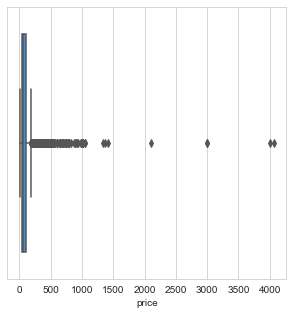

In [44]:
### I will check whether there are any outliers in the "price" column

sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize=[5, 5])
sns.boxplot(listings["price"], color = "dodgerblue")

### I will remove extreme outliers for the price column, which the model then wont be able to 
### predict 

In [45]:
listings = listings[listings["price"] <= 1000]

In [46]:
listings = listings.drop_duplicates()

In [47]:
### I will eliminate the rows where the n_bathrooms > 4, because all of these have only 
### one or two rows, which doesnt serve the model

print(listings["n_bathrooms"].value_counts())
listings = listings[listings["n_bathrooms"] <= 4.0]
listings.shape

1.0    9104
0.0    3952
2.0     744
1.5     713
2.5     109
0.5      44
3.0      30
4.0      10
3.5       7
4.5       3
6.0       1
7.0       1
8.0       1
5.0       1
Name: n_bathrooms, dtype: int64


(14713, 19)

In [48]:
### I will also eliminate the rows where the bedrooms > 7, because all of these have only 
### one or two rows, which doesnt serve the model

print(listings["bedrooms"].value_counts())
listings = listings[listings["bedrooms"] <= 7.0]
listings.shape

1.0     11546
2.0      2327
3.0       634
4.0       152
5.0        36
6.0        10
7.0         6
10.0        1
9.0         1
Name: bedrooms, dtype: int64


(14711, 19)

In [49]:
listings = listings.rename(columns={'neighbourhood_cleansed': 'neighbourhood',
                                   'neighbourhood_group_cleansed': 'district'})

In [50]:
### I will export a csv file with the cleaned data, plus longitude and latitude for the 
### visualization of the datapoints

coordinates = listings_raw[["id", "longitude", "latitude"]]

In [51]:
listings_clean = pd.merge(
    left=listings, 
    right=coordinates, 
    on='id',
    how='inner'
)
#listings_clean.to_csv('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/data/clean/listings_clean.csv', index=False)

In [52]:
### I will transform the "district", "neighbourhood", 
### "property_type" and "room_type" into ordinal columns 

cols = ["neighbourhood", "district", "property_type", "room_type"]

for col in cols:
    df = listings.groupby([col]).agg({"price":"median"}).reset_index()
    df["value"] = df["price"]/df["price"].min()
    df = df[[col,"value"]]
    dict_df = dict(df.values)
    print(dict_df)
    listings[col] = listings[col].map(dict_df)
    print(listings[col].value_counts())

{'Albrechtstr.': 1.3484848484848484, 'Alexanderplatz': 3.0, 'Alt  Treptow': 1.5454545454545454, 'Alt-Hohenschönhausen Süd': 3.212121212121212, 'Alt-Lichtenberg': 1.4393939393939394, 'Barstraße': 1.5151515151515151, 'Baumschulenweg': 1.0, 'Blankenfelde/Niederschönhausen': 2.272727272727273, 'Britz': 1.1818181818181819, 'Brunnenstr. Nord': 1.8333333333333333, 'Brunnenstr. Süd': 2.727272727272727, 'Buch': 1.878787878787879, 'Drakestr.': 2.409090909090909, 'Düsseldorfer Straße': 2.090909090909091, 'Frankfurter Allee Nord': 1.5909090909090908, 'Frankfurter Allee Süd FK': 1.8181818181818181, 'Friedenau': 1.6666666666666667, 'Gatow / Kladow': 2.4242424242424243, 'Grunewald': 1.878787878787879, 'Halensee': 1.9696969696969697, 'Heerstrasse': 2.090909090909091, 'Helmholtzplatz': 2.242424242424242, 'Kantstraße': 2.090909090909091, 'Karl-Marx-Allee-Nord': 1.8181818181818181, 'Karl-Marx-Allee-Süd': 1.8181818181818181, 'Karlshorst': 1.8333333333333333, 'Kurfürstendamm': 2.712121212121212, 'Mahlsdorf

In [53]:
listings.head()

,id,neighbourhood,district,property_type,room_type,accommodates,n_bathrooms,bedrooms,beds,price,wifi,kitchen,parking,balcony,bbq,washer,host_email,host_phone,host_work_email
0,39971294,1.954545,1.250000,2.677966,2.186667,2,1.0,1.0,1.0,50.0,1,1,1,0,0,1,1,1,1
2,17580693,1.227273,1.458333,1.355932,1.013333,1,0.0,1.0,1.0,42.0,1,0,0,0,0,0,1,1,0
3,579471587567149993,1.666667,1.250000,2.677966,2.186667,2,1.0,1.0,2.0,52.0,1,1,0,0,0,1,1,1,0
4,17497917,3.000000,1.458333,2.677966,2.186667,2,1.0,1.0,1.0,106.0,1,1,1,1,0,1,1,1,1
5,9924899,1.818182,1.250000,1.186441,1.013333,1,0.0,1.0,1.0,39.0,1,1,0,0,0,0,1,1,0


In [54]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14711 entries, 0 to 16413
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               14711 non-null  int64  
 1   neighbourhood    14711 non-null  float64
 2   district         14711 non-null  float64
 3   property_type    14711 non-null  float64
 4   room_type        14711 non-null  float64
 5   accommodates     14711 non-null  int64  
 6   n_bathrooms      14711 non-null  float64
 7   bedrooms         14711 non-null  float64
 8   beds             14711 non-null  float64
 9   price            14711 non-null  float64
 10  wifi             14711 non-null  int64  
 11  kitchen          14711 non-null  int64  
 12  parking          14711 non-null  int64  
 13  balcony          14711 non-null  int64  
 14  bbq              14711 non-null  int64  
 15  washer           14711 non-null  int64  
 16  host_email       14711 non-null  int64  
 17  host_phone  

In [ ]:
for col in listings.columns:
    sns.set_style("ticks")
    fig, ax = plt.subplots(figsize=[5, 5])
    sns.histplot(listings[col], color = "dodgerblue")
    #filename = '{}.png'.format(col)
    #plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/'+filename, bbox_inches='tight')
    plt.show()
    
### The price column is heavily skewed!

In [ ]:
corr_matrix = listings[["price", "neighbourhood", "district",
                  "accommodates", "n_bathrooms", "bedrooms", "beds", "room_type",
                   "property_type"]].corr()
sns.set(rc={'figure.figsize':(15,8)})
sns.heatmap(corr_matrix, annot=True)
plt.show()

In [ ]:
listings = listings.drop(["beds"], axis = 1)
listings

In [ ]:
corr_matrix = listings[["price", "neighbourhood", "district",
                  "accommodates", "n_bathrooms", "bedrooms", "room_type", "property_type"]].corr()
sns.set(rc={'figure.figsize':(15,8)})
sns.heatmap(corr_matrix, annot=True)
plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/corr_plot.png', bbox_inches='tight')
plt.show()


In [ ]:
listings = listings.drop(["id"], axis = 1)

In [ ]:
### X,y split

y = listings["price"]
x = listings.drop(["price"], axis = 1)

In [ ]:
### Train-test split

x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 85)
print(x_train.shape)
print(x_test.shape)

In [ ]:
### Normalization

transformer = MinMaxScaler().fit(x_train)

with open("../scalers/min_max_scaler.pkl", "wb") as file:
    pickle.dump(transformer, file)

x_train_norm = transformer.transform(x_train)
x_test_norm = transformer.transform(x_test)
x_train_norm = pd.DataFrame(x_train_norm, columns=x_train.columns, index=x_train.index)
x_test_norm = pd.DataFrame(x_test_norm, columns=x_test.columns, index=x_test.index)
x_train_norm.head()

In [ ]:
### The data from the price column is heavily skewed. I will therefore apply a log 
### transformation on the y_test and y_train data

sns.set_style("ticks")
fig, ax = plt.subplots(figsize=[5, 5])
sns.distplot(y_train, color = "dodgerblue")
plt.show()

In [ ]:
### Log transformation

y_train_log = np.log(y_train)
y_test_log = np.log(y_test)

sns.set_style("ticks")
fig, ax = plt.subplots(figsize=[5, 5])
sns.distplot(y_train_log, color='dodgerblue')
plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/price_log.png', bbox_inches='tight')
plt.show

In [ ]:
### Linear regression model with log y_test and y_train

lm = LinearRegression()
lm.fit(x_train, y_train_log)

with open("../models/lm.pkl", "wb") as file:
    pickle.dump(lm, file)

y_pred_test = lm.predict(x_test)
y_pred_train = lm.predict(x_train)
r2_train = r2_score(np.exp(y_train_log), np.exp(y_pred_train))
mse_train = mean_squared_error(np.exp(y_train_log), np.exp(y_pred_train))
mae_train = mean_absolute_error(np.exp(y_train_log), np.exp(y_pred_train))
mape_train = mean_absolute_percentage_error(np.exp(y_train_log), np.exp(y_pred_train))
print("r2 train:", r2_train)
print("mse train:", mse_train)
print("mae train:", mae_train)
print("mape train:", mape_train)
r2_test = r2_score(np.exp(y_test_log), np.exp(y_pred_test))
mse_test = mean_squared_error(np.exp(y_test_log), np.exp(y_pred_test))
mae_test = mean_absolute_error(np.exp(y_test_log), np.exp(y_pred_test))
mape_test = mean_absolute_percentage_error(np.exp(y_test_log), np.exp(y_pred_test))
print("r2 test:", r2_test)
print("mse test:", mse_test)
print("mae test:", mae_test)
print("mape test:", mape_test)

In [ ]:
column_relevance = list(zip(np.abs(lm.coef_), x_train_norm.columns, lm.coef_))
column_relevance.sort(reverse=True)
column_relevance = [(item[1],item[-1],item[0]) for item in column_relevance]
column_relevance

In [ ]:
sns.set_style("ticks")
fig, ax = plt.subplots(figsize=[5, 5])
sns.scatterplot(np.exp(y_pred_test), y_test, color = "dodgerblue")
plt.xlabel('y_pred_test')
plt.ylabel('y_test')
plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/test_pred.png', bbox_inches='tight')

In [ ]:
error = y_test - np.exp(y_pred_test)
sns.set_style("ticks")
fig, ax = plt.subplots(figsize=[5, 5])
sns.histplot(error, color='dodgerblue', element="step", fill=False)
plt.xlabel('y_test - y_pred_test')
plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/error_png', bbox_inches='tight')

In [ ]:
explainer = shap.Explainer(lm, x_train)
shap_values = explainer(x_test)

In [ ]:
sns.set_style("ticks")
fig, ax = plt.subplots(figsize=[5, 5])
shap.plots.beeswarm(shap_values, max_display=20, show=False)
plt.savefig('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/images/shap.png', bbox_inches = 'tight')